In [ ]:
   import os, cv2
import numpy as np
import pandas as pd
import random, tqdm
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

import torch
import torch.nn as nn
from torch.utils.data import DataLoader
import albumentations as album

In [ ]:
!pip install -q -U segmentation-models-pytorch albumentations > /dev/null
import segmentation_models_pytorch as smp

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os
os.chdir('/content/drive/MyDrive/Machine_Learning/Sand') 
!pwd
%ls

/content/drive/MyDrive/Machine_Learning/Sand
 best_model_current_run/
 best_model_previous_run/
'Copie de Segmentation_PyTorch_Unet++_ResNet34).ipynb'
 datasets/
 datasets_1/
 label_class_dict.csv
 sample_predictions/
 sample_predictions_Deeplabv3_0.958_0.006/
 sample_predictions_Unet++_0.958_0.006/
'Segmentation_PyTorch_DeepLabV3+__ResNet18).ipynb'
'Segmentation_PyTorch_Unet++_ResNet34).ipynb'


In [ ]:
#Defining train / val / test directories
DATA_DIR = 'datasets/'

x_train_dir = os.path.join(DATA_DIR, 'train')
y_train_dir = os.path.join(DATA_DIR, 'train_labels')

x_valid_dir = os.path.join(DATA_DIR, 'validation')
y_valid_dir = os.path.join(DATA_DIR, 'validation_labels')

x_test_dir = os.path.join(DATA_DIR, 'test')
y_test_dir = os.path.join(DATA_DIR, 'test_labels')

In [ ]:
#All dataset classes and their corresponding RGB values in labels
class_dict = pd.read_csv("label_class_dict.csv")
# Get class names
class_names = class_dict['name'].tolist()
# Get class RGB values
class_rgb_values = class_dict[['r','g','b']].values.tolist()

print('All dataset classes and their corresponding RGB values in labels:')
print('Class Names: ', class_names)
print('Class RGB values: ', class_rgb_values)

All dataset classes and their corresponding RGB values in labels:
Class Names:  ['pore', 'grain', 'water', 'air-grain', 'air-water', 'grain-water']
Class RGB values:  [[255, 255, 255], [0, 0, 0], [255, 0, 0], [0, 0, 255], [0, 255, 0], [255, 255, 0]]


In [ ]:
#Shortlist specific classes to segment
# Useful to shortlist specific classes in datasets with large number of classes
select_classes = ['pore', 'grain', 'water', 'air-grain', 'air-water', 'grain-water']

# Get RGB values of required classes
select_class_indices = [class_names.index(cls.lower()) for cls in select_classes]
select_class_rgb_values =  np.array(class_rgb_values)[select_class_indices]

print('Selected classes and their corresponding RGB values in labels:')
print('Selected Names: ', select_classes)
print('Selected Class RGB values: ', select_class_rgb_values)

Selected classes and their corresponding RGB values in labels:
Selected Names:  ['pore', 'grain', 'water', 'air-grain', 'air-water', 'grain-water']
Selected Class RGB values:  [[255 255 255]
 [  0   0   0]
 [255   0   0]
 [  0   0 255]
 [  0 255   0]
 [255 255   0]]


In [ ]:
#Helper functions for viz. & one-hot encoding/decoding
def visualize(**images):
    """
    Plot images in one row
    """
    n_images = len(images)
    plt.figure(figsize=(20,8))
    for idx, (name, image) in enumerate(images.items()):
        plt.subplot(1, n_images, idx + 1)
        plt.xticks([]); 
        plt.yticks([])
        # get title from the parameter names
        plt.title(name.replace('_',' ').title(), fontsize=20)
        plt.imshow(image)
    plt.show()

# Perform one hot encoding on label
def one_hot_encode(label, label_values):
    """
    Convert a segmentation image label array to one-hot format by replacing each pixel value with a vector of length num_classes
    # Arguments
        label: The 2D array segmentation image label
        label_values
        
    # Returns
        A 2D array with the same width and hieght as the input, but with a depth size of num_classes
    """
    semantic_map = []
    for colour in label_values:
        equality = np.equal(label, colour)
        class_map = np.all(equality, axis = -1)
        semantic_map.append(class_map)
    semantic_map = np.stack(semantic_map, axis=-1)

    return semantic_map
    
# Perform reverse one-hot-encoding on labels / preds
def reverse_one_hot(image):
    """
    Transform a 2D array in one-hot format (depth is num_classes),
    to a 2D array with only 1 channel, where each pixel value is
    the classified class key.
    # Arguments
        image: The one-hot format image 
        
    # Returns
        A 2D array with the same width and hieght as the input, but
        with a depth size of 1, where each pixel value is the classified 
        class key.
    """
    x = np.argmax(image, axis = -1)
    return x

# Perform colour coding on the reverse-one-hot outputs
def colour_code_segmentation(image, label_values):
    """
    Given a 1-channel array of class keys, colour code the segmentation results.
    # Arguments
        image: single channel array where each value represents the class key.
        label_values

    # Returns
        Colour coded image for segmentation visualization
    """
    colour_codes = np.array(label_values)
    x = colour_codes[image.astype(int)]

    return x

In [ ]:
class BuildingsDataset(torch.utils.data.Dataset):

    """Massachusetts Buildings Dataset. Read images, apply augmentation and preprocessing transformations.
    
    Args:
        images_dir (str): path to images folder
        masks_dir (str): path to segmentation masks folder
        class_rgb_values (list): RGB values of select classes to extract from segmentation mask
        augmentation (albumentations.Compose): data transfromation pipeline 
            (e.g. flip, scale, etc.)
        preprocessing (albumentations.Compose): data preprocessing 
            (e.g. noralization, shape manipulation, etc.)
    
    """
    
    def __init__(
            self, 
            images_dir, 
            masks_dir, 
            class_rgb_values=None, 
            augmentation=None, 
            preprocessing=None,
    ):
        
        self.image_paths = [os.path.join(images_dir, image_id) for image_id in sorted(os.listdir(images_dir))]
        self.mask_paths = [os.path.join(masks_dir, image_id) for image_id in sorted(os.listdir(masks_dir))]

        self.class_rgb_values = class_rgb_values
        self.augmentation = augmentation
        self.preprocessing = preprocessing
    
    def __getitem__(self, i):
        
        # read images and masks
        image = cv2.cvtColor(cv2.imread(self.image_paths[i]), cv2.COLOR_BGR2RGB)
        mask = cv2.cvtColor(cv2.imread(self.mask_paths[i]), cv2.COLOR_BGR2RGB)
        
        # one-hot-encode the mask
        mask = one_hot_encode(mask, self.class_rgb_values).astype('float')
        
        # apply augmentations
        if self.augmentation:
            sample = self.augmentation(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
        
        # apply preprocessing
        if self.preprocessing:
            sample = self.preprocessing(image=image, mask=mask)
            image, mask = sample['image'], sample['mask']
            
        return image, mask
        
    def __len__(self):
        # return length of 
        return len(self.image_paths)

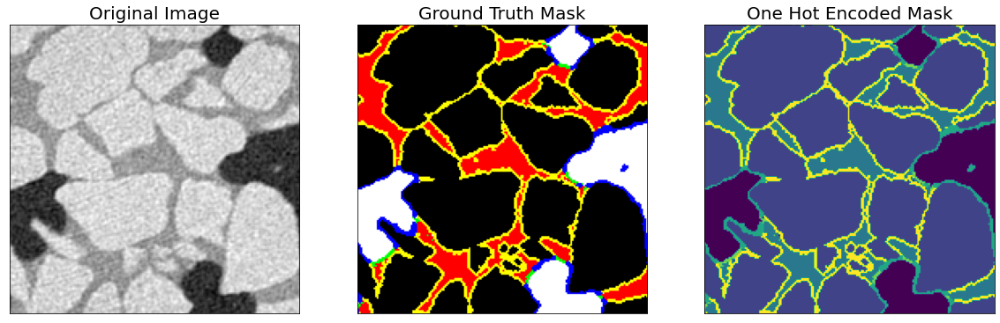

In [ ]:
# Visualize Sample Image and Mask
dataset = BuildingsDataset(x_train_dir, y_train_dir, class_rgb_values=select_class_rgb_values)
random_idx = random.randint(0, len(dataset)-1)
image, mask = dataset[random_idx]

visualize(
    original_image = image,
    ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
    one_hot_encoded_mask = reverse_one_hot(mask)
)

In [ ]:
# Defining Augmentations
def get_training_augmentation():
    train_transform = [    
        album.RandomCrop(height=128, width=128, always_apply=True),
        album.OneOf(
            [
                album.HorizontalFlip(p=1),
                album.VerticalFlip(p=1),
                album.RandomRotate90(p=1),
            ],
            p=0.75,
        ),
    ]
    return album.Compose(train_transform)


def get_validation_augmentation():   
    # Add sufficient padding to ensure image is divisible by 32
    test_transform = [
        #album.PadIfNeeded(min_height=1536, min_width=1536, always_apply=True, border_mode=0),
        album.PadIfNeeded(min_height=192, min_width=192, always_apply=True, border_mode=0),
    ]
    return album.Compose(test_transform)


def to_tensor(x, **kwargs):
    return x.transpose(2, 0, 1).astype('float32')


def get_preprocessing(preprocessing_fn=None):
    """Construct preprocessing transform    
    Args:
        preprocessing_fn (callable): data normalization function 
            (can be specific for each pretrained neural network)
    Return:
        transform: albumentations.Compose
    """   
    _transform = []
    if preprocessing_fn:
        _transform.append(album.Lambda(image=preprocessing_fn))
    _transform.append(album.Lambda(image=to_tensor, mask=to_tensor))
        
    return album.Compose(_transform)



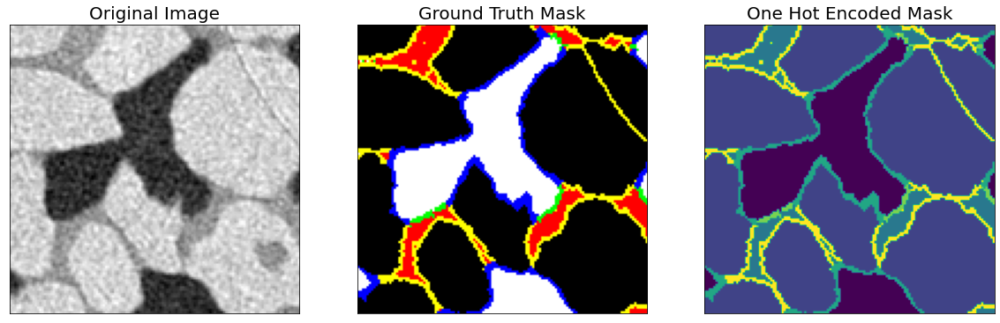

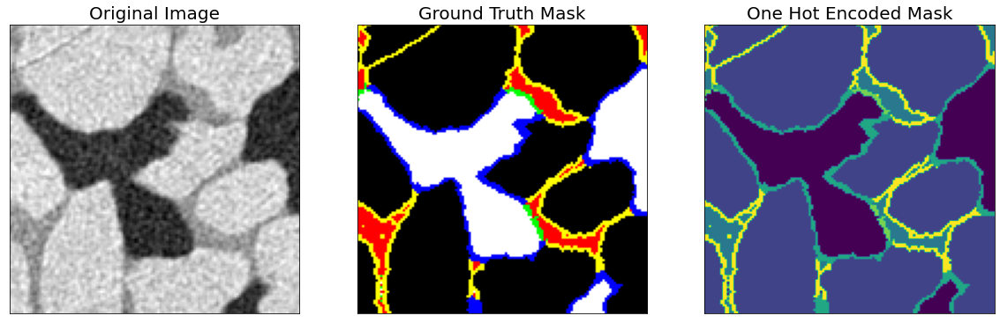

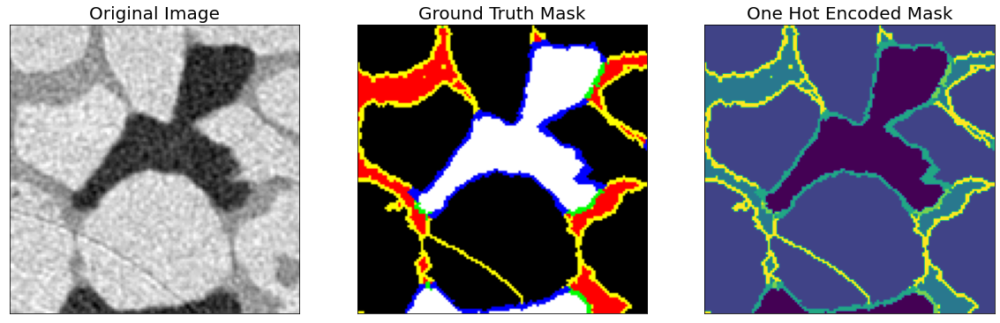

In [ ]:
#Visualize Augmented Images & Masks
augmented_dataset = BuildingsDataset(
    x_train_dir, y_train_dir, 
    augmentation=get_training_augmentation(),
    class_rgb_values=select_class_rgb_values,
)

random_idx = random.randint(0, len(augmented_dataset)-1)

# Different augmentations on a random image/mask pair (256*256 crop)
for i in range(3):
    image, mask = augmented_dataset[random_idx]
    visualize(
        original_image = image,
        ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
        one_hot_encoded_mask = reverse_one_hot(mask)
    )

In [ ]:
#Model Definition_DeepLabV3Plus
ENCODER = 'resnet18'
ENCODER_WEIGHTS = 'imagenet'
ENCODER_DEPTH=5
CLASSES = class_names
ACTIVATION = 'softmax2d' #'sigmoid' # could be None for logits or 'softmax2d' for multiclass segmentation

## create segmentation model with pretrained encoder
model = smp.DeepLabV3Plus(
    encoder_name=ENCODER, 
    encoder_depth=ENCODER_DEPTH,
    encoder_weights=ENCODER_WEIGHTS, 
    classes=len(CLASSES), 
    activation=ACTIVATION,
)

preprocessing_fn = smp.encoders.get_preprocessing_fn(ENCODER, ENCODER_WEIGHTS)

In [ ]:
#!pip install -U git+https://github.com/albu/albumentations --no-cache-dir

# Get train and val dataset instances
train_dataset = BuildingsDataset(
    x_train_dir, y_train_dir, 
    augmentation=get_training_augmentation(),
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)

valid_dataset = BuildingsDataset(
    x_valid_dir, y_valid_dir, 
    augmentation=get_validation_augmentation(), 
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)

# Get train and val data loaders
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True, num_workers=6, drop_last=True)
valid_loader = DataLoader(valid_dataset, batch_size=32, shuffle=False, num_workers=2, drop_last=True)

In [ ]:
# Set Hyperparams
# Set flag to train the model or not. If set to 'False', only prediction is performed (using an older model checkpoint)
TRAINING = True

# Set num of epochs
EPOCHS = 200

# Set device: `cuda` or `cpu`
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# define loss function
#loss = smp.utils.losses.constants.MULTICLASS_MODE()
loss = smp.utils.losses.DiceLoss()

# define metrics
metrics = [
    smp.utils.metrics.IoU(threshold=0.5),
]

# define optimizer
optimizer = torch.optim.Adam([ 
    dict(params=model.parameters(), lr=0.0001, weight_decay=0.006),
])

# define learning rate scheduler (not used in this NB)
lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
    optimizer, T_0=1, T_mult=2, eta_min=5e-5,
)

# load best saved model checkpoint from previous commit (if present)
if os.path.exists('best_model_previous_run/best_model.pth'):
    model = torch.load('best_model_previous_run/best_model.pth', map_location=DEVICE)

In [ ]:
train_epoch = smp.utils.train.TrainEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    optimizer=optimizer,
    device=DEVICE,
    verbose=True,
)

valid_epoch = smp.utils.train.ValidEpoch(
    model, 
    loss=loss, 
    metrics=metrics, 
    device=DEVICE,
    verbose=True,
)

In [ ]:
# Training DeepLabV3+
%%time

if TRAINING:

    best_iou_score = 0.0
    train_logs_list, valid_logs_list = [], []

    for i in range(0, EPOCHS):

        # Perform training & validation
        print('\nEpoch: {}'.format(i))
        train_logs = train_epoch.run(train_loader)
        valid_logs = valid_epoch.run(valid_loader)
        train_logs_list.append(train_logs)
        valid_logs_list.append(valid_logs)

        # Save model if a better val IoU score is obtained
        if best_iou_score < valid_logs['iou_score']:
            best_iou_score = valid_logs['iou_score']
            torch.save(model, 'best_model_current_run/best_model.pth')
            print('Model saved!')


Epoch: 0
valid: 100%|██████████| 3/3 [00:01<00:00,  1.91it/s, dice_loss - 0.8423, iou_score - 9.645e-14]
Model saved!

Epoch: 1
valid: 100%|██████████| 3/3 [00:01<00:00,  1.89it/s, dice_loss - 0.8404, iou_score - 9.645e-14]

Epoch: 2
valid: 100%|██████████| 3/3 [00:01<00:00,  1.89it/s, dice_loss - 0.8339, iou_score - 9.645e-14]

Epoch: 3
valid: 100%|██████████| 3/3 [00:01<00:00,  1.94it/s, dice_loss - 0.8194, iou_score - 9.645e-14]

Epoch: 4
valid: 100%|██████████| 3/3 [00:01<00:00,  1.89it/s, dice_loss - 0.7955, iou_score - 0.01686]
Model saved!

Epoch: 5
valid: 100%|██████████| 3/3 [00:01<00:00,  1.90it/s, dice_loss - 0.7515, iou_score - 0.1309]
Model saved!

Epoch: 6
valid: 100%|██████████| 3/3 [00:01<00:00,  1.88it/s, dice_loss - 0.6413, iou_score - 0.2999]
Model saved!

Epoch: 7
valid: 100%|██████████| 3/3 [00:01<00:00,  1.89it/s, dice_loss - 0.5526, iou_score - 0.4392]
Model saved!

Epoch: 8
valid: 100%|██████████| 3/3 [00:01<00:00,  1.91it/s, dice_loss - 0.4767, iou_score - 0.5

In [ ]:
# Prediction on Test Data
# load best saved model checkpoint from the current run
if os.path.exists('best_model_current_run/best_model.pth'):
    best_model = torch.load('best_model_current_run/best_model.pth', map_location=DEVICE)
    print('Loaded DeepLabV3+ model from this run.')

# load best saved model checkpoint from previous commit (if present)
elif os.path.exists('best_model_previous_run/best_model.pth'):
    best_model = torch.load('best_model_previous_run/best_model.pth', map_location=DEVICE)
    print('Loaded DeepLabV3+ model from a previous commit.')

Loaded DeepLabV3+ model from this run.


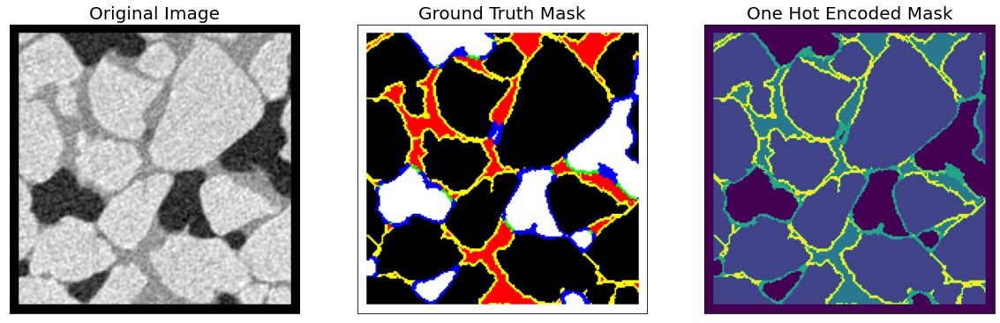

In [ ]:
# create test dataloader (with preprocessing operation: to_tensor(...))
test_dataset = BuildingsDataset(
    x_test_dir, 
    y_test_dir, 
    augmentation=get_validation_augmentation(), 
    preprocessing=get_preprocessing(preprocessing_fn),
    class_rgb_values=select_class_rgb_values,
)

test_dataloader = DataLoader(test_dataset)

# test dataset for visualization (without preprocessing transformations)
test_dataset_vis = BuildingsDataset(
    x_test_dir, y_test_dir, 
    augmentation=get_validation_augmentation(),
    class_rgb_values=select_class_rgb_values,
)

# get a random test image/mask index
random_idx = random.randint(0, len(test_dataset_vis)-1)
image, mask = test_dataset_vis[random_idx]

visualize(
    original_image = image,
    ground_truth_mask = colour_code_segmentation(reverse_one_hot(mask), select_class_rgb_values),
    one_hot_encoded_mask = reverse_one_hot(mask)
)

In [ ]:
# Center crop padded image / mask to original image dims
def crop_image(image, target_image_dims=[150,150,3]):
   
    target_size = target_image_dims[0]
    image_size = len(image)
    padding = (image_size - target_size) // 2

    return image[
        padding:image_size - padding,
        padding:image_size - padding,
        :,
    ]

In [ ]:
sample_preds_folder = 'sample_predictions/'
if not os.path.exists(sample_preds_folder):
    os.makedirs(sample_preds_folder)

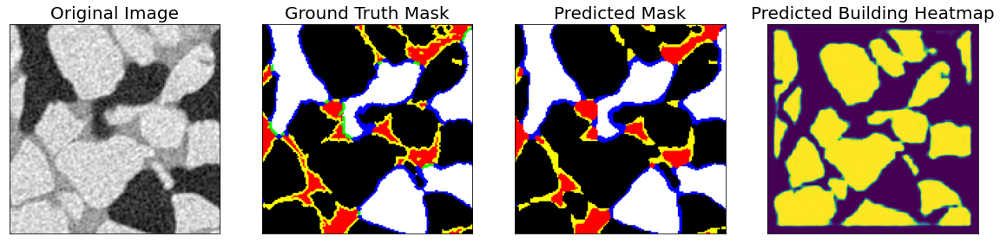

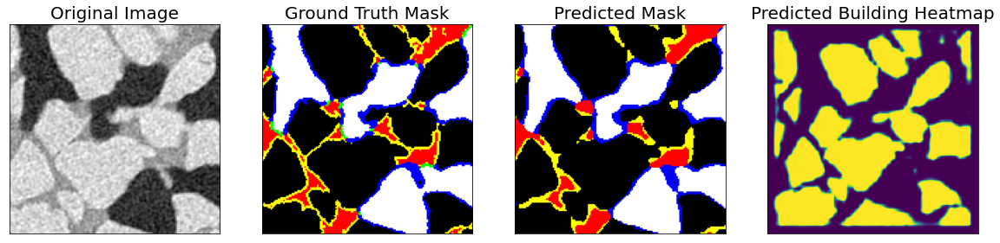

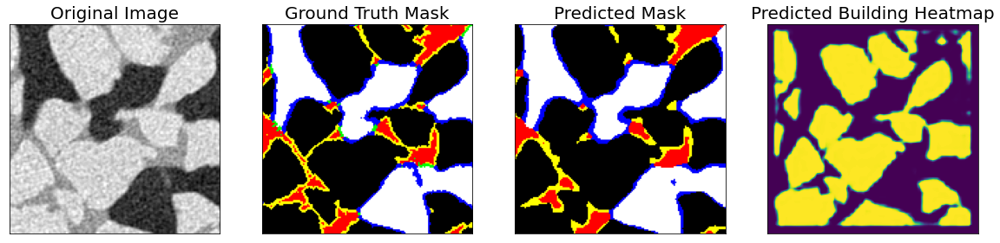

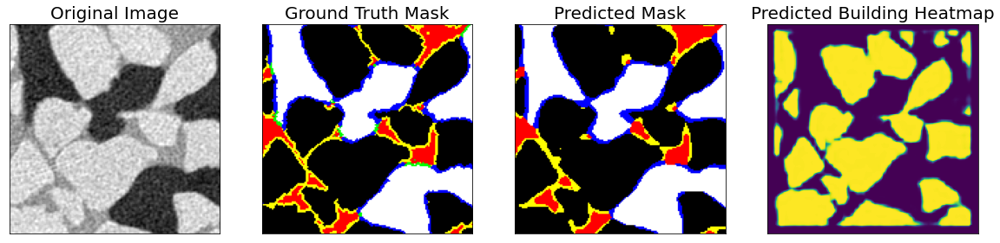

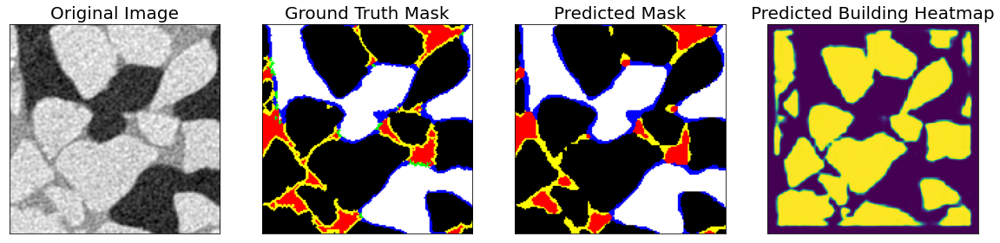

...

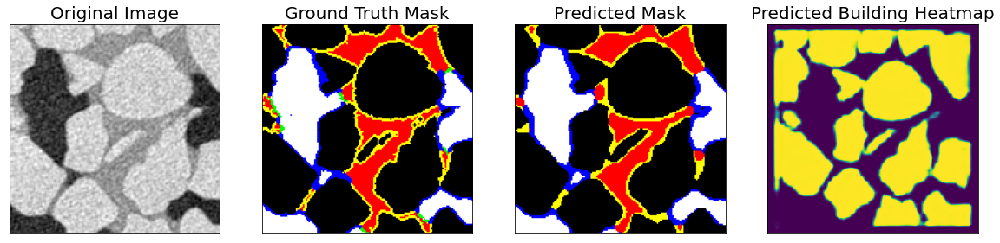

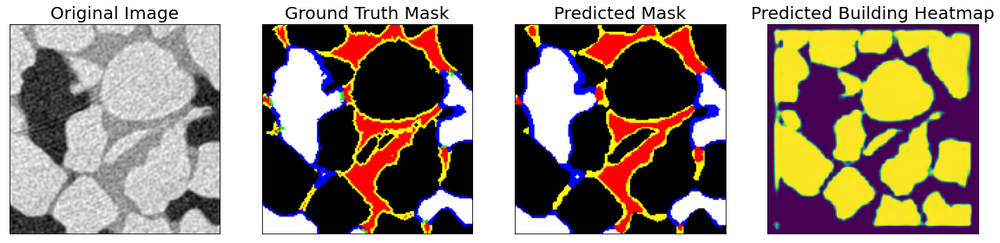

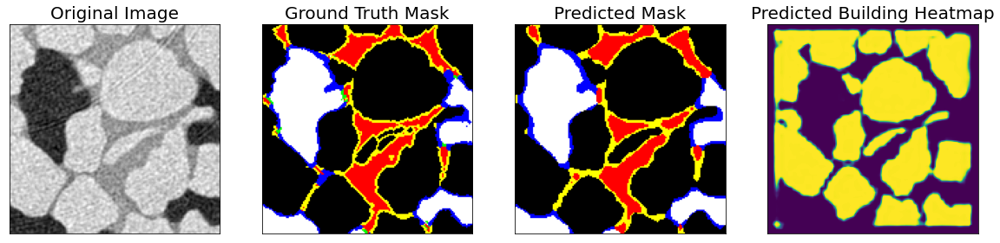

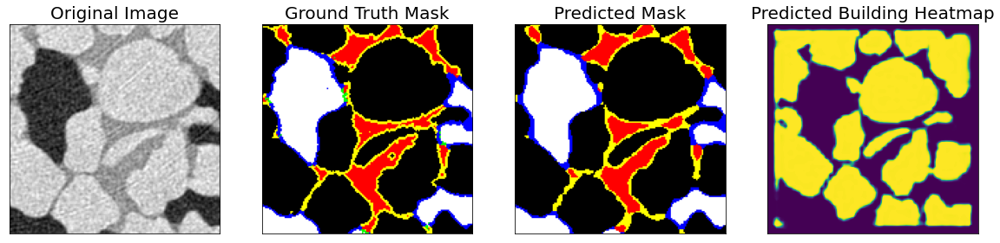

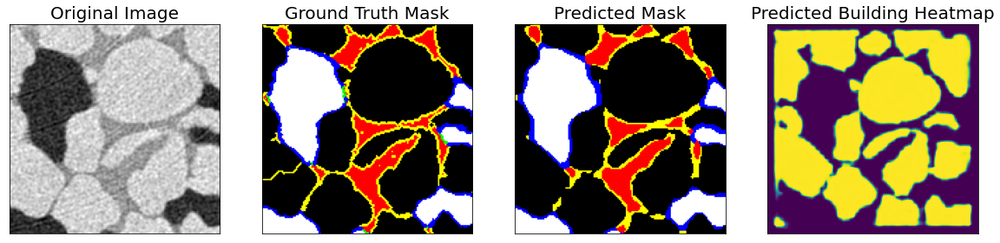

In [ ]:
for idx in range(len(test_dataset)):

    image, gt_mask = test_dataset[idx]
    image_vis = crop_image(test_dataset_vis[idx][0].astype('uint8'))
    x_tensor = torch.from_numpy(image).to(DEVICE).unsqueeze(0)
    # Predict test image
    pred_mask = best_model(x_tensor)
    pred_mask = pred_mask.detach().squeeze().cpu().numpy()
    # Convert pred_mask from `CHW` format to `HWC` format
    pred_mask = np.transpose(pred_mask,(1,2,0))
    # Get prediction channel corresponding to building
    pred_grainmap = pred_mask[:,:,select_classes.index('grain')]
    pred_mask = crop_image(colour_code_segmentation(reverse_one_hot(pred_mask), select_class_rgb_values))
    # Convert gt_mask from `CHW` format to `HWC` format
    gt_mask = np.transpose(gt_mask,(1,2,0))
    gt_mask = crop_image(colour_code_segmentation(reverse_one_hot(gt_mask), select_class_rgb_values))
    cv2.imwrite(os.path.join(sample_preds_folder, f"sample_pred_{idx}.tif"), np.hstack([image_vis, gt_mask, pred_mask])[:,:,::-1])
    
    visualize(
        original_image = image_vis,
        ground_truth_mask = gt_mask,
        predicted_mask = pred_mask,
        predicted_building_heatmap = pred_grainmap
    )

In [ ]:
# Model Evaluation on Test Dataset
test_epoch = smp.utils.train.ValidEpoch(
    model,
    loss=loss, 
    metrics=metrics, 
    device=DEVICE,
    verbose=True,
)

valid_logs = test_epoch.run(test_dataloader)
print("Evaluation on Test Data: ")
print(f"Mean IoU Score: {valid_logs['iou_score']:.4f}")
print(f"Mean Dice Loss: {valid_logs['dice_loss']:.4f}")

valid: 100%|██████████| 97/97 [00:03<00:00, 26.17it/s, dice_loss - 0.1746, iou_score - 0.7332]
Evaluation on Test Data: 
Mean IoU Score: 0.7332
Mean Dice Loss: 0.1746


In [ ]:
#Plot Dice Loss & IoU Metric for Train vs. Val
train_logs_df = pd.DataFrame(train_logs_list)
valid_logs_df = pd.DataFrame(valid_logs_list)
train_logs_df.T

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199
dice_loss,0.810423,0.780383,0.738110,0.684549,0.625679,0.573814,0.529351,0.489521,0.458067,0.429080,0.404005,0.381236,0.355706,0.333239,0.312966,0.294257,0.277211,0.263367,0.250068,0.238848,0.229548,0.221549,0.21447,0.207192,0.202194,0.198108,0.193426,0.190724,0.186180,0.183822,0.180131,0.177580,0.175974,0.173913,0.171979,0.170756,0.168681,0.167918,0.166076,0.164997,...,0.102360,0.102071,0.102387,0.101962,0.102419,0.100819,0.101196,0.100954,0.100855,0.101700,0.099921,0.100558,0.100239,0.101193,0.099948,0.099489,0.100269,0.100512,0.099502,0.099298,0.098800,0.098745,0.098984,0.098533,0.098768,0.097734,0.097777,0.09846,0.097322,0.098080,0.098094,0.097934,0.096651,0.097378,0.096892,0.096484,0.097271,0.096319,0.096458,0.096688
iou_score,0.001801,0.015774,0.068158,0.164091,0.280777,0.364452,0.425710,0.477134,0.509047,0.547057,0.576852,0.600854,0.632613,0.660141,0.684531,0.704604,0.721267,0.731492,0.740358,0.745990,0.749345,0.753154,0.75565,0.758722,0.760061,0.760711,0.762556,0.762762,0.765402,0.764678,0.766078,0.766848,0.766709,0.766881,0.767449,0.767772,0.767698,0.767057,0.768055,0.767580,...,0.852212,0.853283,0.852452,0.852793,0.851979,0.855399,0.854044,0.854415,0.854481,0.853103,0.855886,0.854972,0.855351,0.853295,0.855546,0.855694,0.854986,0.854031,0.855751,0.856485,0.857683,0.857004,0.856944,0.857880,0.857091,0.859219,0.859082,0.85799,0.859512,0.858092,0.857480,0.858382,0.860521,0.858910,0.859767,0.860127,0.858594,0.860092,0.860070,0.859664


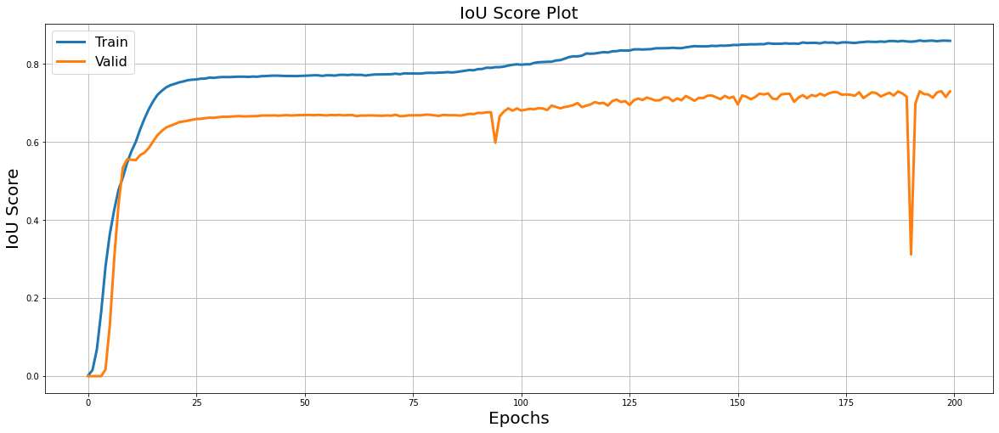

In [ ]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.iou_score.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.iou_score.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('IoU Score', fontsize=20)
plt.title('IoU Score Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('iou_score_plot.png')
plt.show()

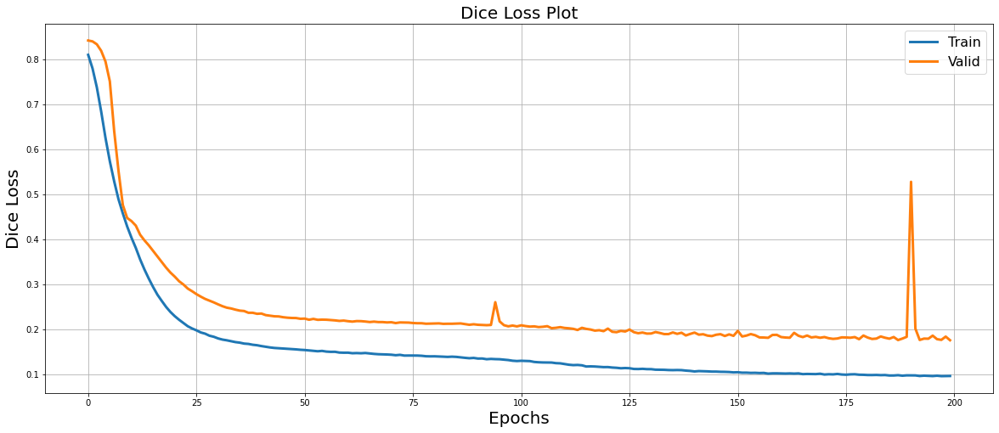

In [ ]:
plt.figure(figsize=(20,8))
plt.plot(train_logs_df.index.tolist(), train_logs_df.dice_loss.tolist(), lw=3, label = 'Train')
plt.plot(valid_logs_df.index.tolist(), valid_logs_df.dice_loss.tolist(), lw=3, label = 'Valid')
plt.xlabel('Epochs', fontsize=20)
plt.ylabel('Dice Loss', fontsize=20)
plt.title('Dice Loss Plot', fontsize=20)
plt.legend(loc='best', fontsize=16)
plt.grid()
plt.savefig('dice_loss_plot.png')
plt.show()